In [ ]:
# Copyright (c) Meta Platforms, Inc. and affiliates. All rights reserved.

# Render a colored point cloud

This tutorial shows how to:
- set up a renderer
- render the point cloud
- vary the rendering settings such as compositing and camera position

## Import modules

Ensure `torch` and `torchvision` are installed. If `pytorch3d` is not installed, install it using the following cell:

In [1]:
#use pytorch3d-env1
#WARNING: DO NOT PRESS THE SAVE BUTTON THROUGHOUT EXECUTION/USING THIS NOTEBOOK. ONLY DO AT THE END
!module load cuda



In [14]:
!source activate pytorch3d-env1
import os
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt

# Util function for loading point clouds|
import numpy as np

# Data structures and functions for rendering
from pytorch3d.structures import Pointclouds
from pytorch3d.vis.plotly_vis import AxisArgs, plot_batch_individually, plot_scene
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVOrthographicCameras,
    FoVPerspectiveCameras,
    PointsRasterizationSettings,
    PointsRenderer,
    PulsarPointsRenderer,
    PointsRasterizer,
    AlphaCompositor,
    NormWeightedCompositor
)

### Load a point cloud and corresponding colors

Load and create a **Point Cloud** object.

**Pointclouds** is a unique datastructure provided in PyTorch3D for working with batches of point clouds of different sizes.

If running this notebook using **Google Colab**, run the following cell to fetch the pointcloud data and save it at the path `data/PittsburghBridge`:
If running locally, the data is already available at the correct path.

In [15]:

from plyfile import PlyData
from pytorch3d.structures import Pointclouds
device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")
def read_pointcloud_raw(ply_path):
    device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")
    ply_data = PlyData.read(ply_path)
    verts_data = ply_data['vertex']
    verts = torch.tensor([(v['x'], v['y'], v['z']) for v in verts_data], dtype=torch.float32).to(device)
    rgb = torch.tensor([(v['red'], v['green'], v['blue']) for v in verts_data], dtype=torch.float32).to(device) / 255.0
    # Optional rotation:
    return verts, rgb

In [16]:
# WITH COLOR


# Setup

# Set paths
# obj_filename="/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/temporary-pointclouds/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply" # for single scenario
#For multiple scenario
obj_filename= "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scanned-data-outdoor-stage2-low-height-processed/evaluations/nerfacto/60000/evaluation/CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply"
verts, rgb = read_pointcloud_raw(obj_filename)

# Centering the point cloud
GLOBAL_centroid = verts.mean(dim=0)
verts -= GLOBAL_centroid

point_cloud = Pointclouds(points=[verts], features=[rgb])

### Exploration

In [17]:

import ipywidgets as widgets
from pytorch3d.renderer import (
    look_at_view_transform, 
    FoVOrthographicCameras, 
    PointsRasterizationSettings, 
    PointsRasterizer, 
    PointsRenderer, 
    AlphaCompositor
)
import matplotlib.pyplot as plt

# Assume that device and point_cloud variables have been defined above this code

# Initialize sliders for azimuth, elevation, and distance
azimuth_slider = widgets.FloatSlider(value=0, min=-180, max=180, step=1, description="Azimuth:")
elevation_slider = widgets.FloatSlider(value=0, min=-90, max=90, step=1, description="Elevation:")
distance_slider = widgets.FloatSlider(value=4, min=0.1, max=100, step=0.1, description="Distance:")

@widgets.interact(azimuth=azimuth_slider, elevation=elevation_slider, distance=distance_slider)
def update_and_render(azimuth=0, elevation=10, distance=20):
    # Get the rotation and translation matrices
    R, T = look_at_view_transform(distance, elevation, azimuth, device=device)

    # rotation_matrix = torch.tensor([[0, 0, 1],
    #                             [0, 1, 0],
    #                             [-1, 0, 0]], device=device, dtype=torch.float32)
                                

    # rotation_matrix = torch.tensor([[0, -1, 0],
    #                             [1, 0, 0],
    #                             [0, 0, 1]], device=device, dtype=torch.float32)

    rotation_matrix = torch.tensor([[0, 0, -1],
                                [0, 1, 0],
                                [1, 0, 0]], device=device, dtype=torch.float32)











    # Multiply the rotation matrices to apply the additional rotation
    R = torch.matmul(R, rotation_matrix)

    # Set the camera with the provided settings.
    # cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)
    cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)

    # Define the settings for rasterization and shading.
    raster_settings = PointsRasterizationSettings(
        image_size=256,
        radius=0.003,
        points_per_pixel=15
    )

    # Create a points renderer by compositing points using an alpha compositor.
    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        compositor=AlphaCompositor(background_color=(1, 1, 1))
    )

    images = renderer(point_cloud)
    
    # Display the rendered image
    plt.figure(figsize=(10, 10))
    plt.imshow(images[0, ..., :3].cpu().numpy())
    plt.axis("off")
    plt.show()

interactive(children=(FloatSlider(value=0.0, description='Azimuth:', max=180.0, min=-180.0, step=1.0), FloatSl…

### Image Generation


In [23]:
# Initialize a camera.
# look_at_view_transform parameters in order are: 
# R, T = look_at_view_transform(1.5, -89, 0) #for single scenario
R, T = look_at_view_transform(2.5, 0, 0, device=device) #for single scenario

rotation_matrix = torch.tensor([[0, 0, -1],
                            [0, 1, 0],
                            [1, 0, 0]], device=device, dtype=torch.float32)


# Multiply the rotation matrices to apply the additional rotation
R = torch.matmul(R, rotation_matrix)

# cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)
cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)


raster_settings = PointsRasterizationSettings(
    image_size=(256*3, 192*3),  # Updated image size
    radius=0.003,
    points_per_pixel=2
)

# Create a points renderer by compositing points using an alpha compositor (nearer points
# are weighted more heavily). See [1] for an explanation.
rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
renderer = PointsRenderer(
    rasterizer=rasterizer,
    compositor=AlphaCompositor(background_color=(1, 1, 1))
)

images = renderer(point_cloud)



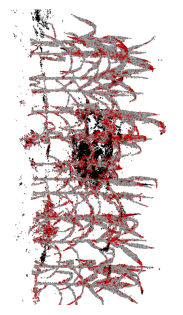

In [24]:
# Assuming images is already defined
left_percent, right_percent, upper_percent, lower_percent = 15, 15, 0, 5 # for single scenario
percent_cut = (left_percent, right_percent, upper_percent, lower_percent)  # Define the percentage to cut from each side

image_width, image_height = images.shape[2], images.shape[1]  # Get the dimensions of the image

zoom_area = (
    image_width * percent_cut[0] / 100,  # x_min
    image_width * (1 - percent_cut[1] / 100),  # x_max
    image_height * (1 - percent_cut[2] / 100),  # y_max
    image_height * percent_cut[3] / 100  # y_min
)

plt.figure(figsize=(2.56*2, 1.92*2), dpi=100)
plt.imshow(images[0, ..., :3].cpu().numpy(), extent=(0, image_width, 0, image_height))  # Set the extent of the image to its actual dimensions
plt.xlim(zoom_area[0], zoom_area[1])  # Set the x-limits to zoom into the desired area
plt.ylim(zoom_area[3], zoom_area[2])  # Set the y-limits to zoom into the desired area, note the order is reversed for ylim
plt.axis("off")

# Save the image with desired pixel size
plt.savefig("rendered_image_zoomed.png", bbox_inches='tight', pad_inches=0, dpi=100)
from PIL import Image

img = Image.open("rendered_image_zoomed.png")
rotated_img = img.rotate(90, expand=True)
rotated_img.save("rendered_image_zoomed_rotated.png")

## Automation

### For Multiple

In [10]:
import torch
import os
from PIL import Image
from plyfile import PlyData
from pytorch3d.structures import Pointclouds
import matplotlib.pyplot as plt
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVPerspectiveCameras,
    PointsRasterizationSettings,
    PointsRasterizer,
    PointsRenderer,
    AlphaCompositor
)

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

def read_pointcloud_raw(ply_path):
    ply_data = PlyData.read(ply_path)
    verts_data = ply_data['vertex']
    verts = torch.tensor([(v['x'], v['y'], v['z']) for v in verts_data], dtype=torch.float32).to(device)
    rgb = torch.tensor([(v['red'], v['green'], v['blue']) for v in verts_data], dtype=torch.float32).to(device) / 255.0
    return verts, rgb

def render_pointcloud(ply_path, output_image_path, GLOBAL_centroid):
    verts, rgb = read_pointcloud_raw(ply_path)
    verts -= GLOBAL_centroid

    point_cloud = Pointclouds(points=[verts], features=[rgb])
    R, T = look_at_view_transform(2.5, 0, 0, device=device)

    rotation_matrix = torch.tensor([[0, 0, -1],
                            [0, 1, 0],
                            [1, 0, 0]], device=device, dtype=torch.float32)


# Multiply the rotation matrices to apply the additional rotation
    R = torch.matmul(R, rotation_matrix)
    cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)

    raster_settings = PointsRasterizationSettings(
        # image_size=(256*3, 192*3),
        image_size=(256*6, 192*6), # For single scenario
        radius=0.003,
        points_per_pixel=2
    )

    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        compositor=AlphaCompositor(background_color=(1, 1, 1))
    )

    images = renderer(point_cloud)
    left_percent, right_percent, upper_percent, lower_percent = 15, 15, 0, 5
    percent_cut = (left_percent, right_percent, upper_percent, lower_percent)
    image_width, image_height = images.shape[2], images.shape[1]

    zoom_area = (
        image_width * percent_cut[0] / 100,
        image_width * (1 - percent_cut[1] / 100),
        image_height * (1 - percent_cut[2] / 100),
        image_height * percent_cut[3] / 100
    )

    # plt.figure(figsize=(2.56*2, 1.92*2), dpi=100) # For single scenario
    plt.figure(figsize=(2.56*4, 1.92*4), dpi=100)

    plt.imshow(images[0, ..., :3].cpu().numpy(), extent=(0, image_width, 0, image_height))
    plt.xlim(zoom_area[0], zoom_area[1])
    plt.ylim(zoom_area[3], zoom_area[2])
    plt.axis("off")
    plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0, dpi=100)
    #Rotate is only for multiple scenario
    img = Image.open(output_image_path)
    rotated_img = img.rotate(90, expand=True)
    rotated_img.save(output_image_path)
    img.close()
    plt.close()

# Iterating through all
# root_dir = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scannned-data-single-img-50-qual-90-processed/evaluations" # For single scenario
root_dir= "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scanned-data-multiple-polycam-images-processed/evaluations"
output_folder = "rendered-pointcloud-images-multiple-scenario"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# first_ply_file_path = os.path.join(root_dir, os.listdir(root_dir)[0], os.listdir(os.path.join(root_dir, os.listdir(root_dir)[0]))[0], "evaluation", "some_file.ply")
# first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/temporary-pointclouds/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply"# For single scenario
first_ply_file_path = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scanned-data-multiple-polycam-images-processed/evaluations/nerfacto/30000/evaluation/CCL-scanned-data-multiple-polycam-images-processed.precision.ply" # For mmultiple scenario

GLOBAL_centroid = read_pointcloud_raw(first_ply_file_path)[0].mean(dim=0)

for model in [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]:
    model_dir = os.path.join(root_dir, model)
    for iteration in os.listdir(model_dir):
        iteration_dir = os.path.join(model_dir, iteration, "evaluation")
        try:
            for file_name in os.listdir(iteration_dir):
                if file_name.endswith(".ply"):
                    ply_file_path = os.path.join(iteration_dir, file_name)
                    output_image_name = f"{model}-{iteration}-{file_name}.png"
                    output_image_path = os.path.join(output_folder, output_image_name)
                    render_pointcloud(ply_file_path, output_image_path, GLOBAL_centroid)
                    print(f"Rendered {output_image_name}")
        except:
            print(f"Error occured while processing {iteration_dir}")

print("Processing completed!")


Rendered nerfacto-100-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered nerfacto-100-CCL-scanned-data-multiple-polycam-images-processed.precision.ply.png
Rendered nerfacto-200-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered nerfacto-200-CCL-scanned-data-multiple-polycam-images-processed.precision.ply.png
Rendered nerfacto-800-CCL-scanned-data-multiple-polycam-images-processed.precision.ply.png
Rendered nerfacto-800-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered nerfacto-10000-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered nerfacto-10000-CCL-scanned-data-multiple-polycam-images-processed.precision.ply.png
Rendered nerfacto-20000-CCL-scanned-data-multiple-polycam-images-processed.precision.ply.png
Rendered nerfacto-20000-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered nerfacto-1000-CCL-scanned-data-multiple-polycam-images-processed.recall.ply.png
Rendered

### For Single

In [13]:
import torch
import os
from PIL import Image
from plyfile import PlyData
from pytorch3d.structures import Pointclouds
import matplotlib.pyplot as plt
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVPerspectiveCameras,
    PointsRasterizationSettings,
    PointsRasterizer,
    PointsRenderer,
    AlphaCompositor
)

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

def read_pointcloud_raw(ply_path):
    ply_data = PlyData.read(ply_path)
    verts_data = ply_data['vertex']
    verts = torch.tensor([(v['x'], v['y'], v['z']) for v in verts_data], dtype=torch.float32).to(device)
    rgb = torch.tensor([(v['red'], v['green'], v['blue']) for v in verts_data], dtype=torch.float32).to(device) / 255.0
    return verts, rgb

def render_pointcloud(ply_path, output_image_path, GLOBAL_centroid):
    verts, rgb = read_pointcloud_raw(ply_path)
    #applying optional transofmration
    # if ply_path.endswith("point_cloud.ply"):
    #     transform_matrix = np.array([
    #     [-1.34, 0.67, -0.03, -0.19],
    #     [-0.67, -1.34, -0.03, 2.39],
    #     [-0.04, -0.01, 1.5, 70.25],
    #     [0.0, 0.0, 0.0, 1.0]
    #     ])

    #     transform_matrix = torch.tensor(transform_matrix, device=device).float()

    #     verts, rgb = read_pointcloud_raw(ply_path)
    #     homogeneous_coords = torch.cat([torch.tensor(verts, device=device).float(), torch.ones(verts.shape[0], 1, device=device).float()], dim=1)
    #     transformed_coords = torch.mm(homogeneous_coords, transform_matrix.t())
    #     verts = transformed_coords[:, :3]

    verts -= GLOBAL_centroid

    point_cloud = Pointclouds(points=[verts], features=[rgb])
    R, T = look_at_view_transform(1.5, -89, 0, device=device)

#     rotation_matrix = torch.tensor([[0, 0, -1],
#                             [0, 1, 0],
#                             [1, 0, 0]], device=device, dtype=torch.float32)


# # Multiply the rotation matrices to apply the additional rotation
#     R = torch.matmul(R, rotation_matrix)
    cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)

    raster_settings = PointsRasterizationSettings(
        image_size=(256*6, 192*6),
        # image_size=(256*, 192*6), # For single scenario
        radius=0.003,
        points_per_pixel=2
    )

    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        compositor=AlphaCompositor(background_color=(1, 1, 1))
    )

    images = renderer(point_cloud)
    left_percent, right_percent, upper_percent, lower_percent = 15, 15, 0, 5
    percent_cut = (left_percent, right_percent, upper_percent, lower_percent)
    image_width, image_height = images.shape[2], images.shape[1]

    zoom_area = (
        image_width * percent_cut[0] / 100,
        image_width * (1 - percent_cut[1] / 100),
        image_height * (1 - percent_cut[2] / 100),
        image_height * percent_cut[3] / 100
    )

    plt.figure(figsize=(2.56*4, 1.92*4), dpi=100) # For single scenario
    # plt.figure(figsize=(2.56*4, 1.92*4), dpi=100)

    plt.imshow(images[0, ..., :3].cpu().numpy(), extent=(0, image_width, 0, image_height))
    plt.xlim(zoom_area[0], zoom_area[1])
    plt.ylim(zoom_area[3], zoom_area[2])
    plt.axis("off")
    plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0, dpi=100)
    # #Rotate is only for multiple scenario
    # img = Image.open(output_image_path)
    # rotated_img = img.rotate(90, expand=True)
    # rotated_img.save(output_image_path)
    # img.close()
    plt.close()

# Iterating through all
root_dir = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scannned-data-single-img-50-qual-90-processed/evaluations" # For single scenario
# root_dir= "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/single-view-detail"
output_folder = "rendered-pointcloud-images-single-scenario"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# first_ply_file_path = os.path.join(root_dir, os.listdir(root_dir)[0], os.listdir(os.path.join(root_dir, os.listdir(root_dir)[0]))[0], "evaluation", "some_file.ply")
# first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/temporary-pointclouds/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply"# For single scenario
first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/single-view-detail/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply" # For mmultiple scenario

GLOBAL_centroid = read_pointcloud_raw(first_ply_file_path)[0].mean(dim=0)

# for file_name in os.listdir(root_dir):
#     if file_name.endswith(".ply"):

#         ply_file_path = os.path.join(root_dir, file_name)
#         output_image_name = f"{file_name}.png"
#         output_image_path = os.path.join(output_folder, output_image_name)
#         render_pointcloud(ply_file_path, output_image_path, GLOBAL_centroid)
#         print(f"Rendered {output_image_name}")

# for model in [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]:
for model in ["nerfacto", "instant-ngp", "tensorf"]:
    model_dir = os.path.join(root_dir, model)
    for iteration in os.listdir(model_dir):
        iteration_dir = os.path.join(model_dir, iteration, "evaluation")
        try:
            for file_name in os.listdir(iteration_dir):
                if file_name.endswith(".ply"):
                    ply_file_path = os.path.join(iteration_dir, file_name)
                    output_image_name = f"{model}-{iteration}-{file_name}.png"
                    output_image_path = os.path.join(output_folder, output_image_name)
                    render_pointcloud(ply_file_path, output_image_path, GLOBAL_centroid)
                    print(f"Rendered {output_image_name}")
        except:
            print(f"Error occured while processing {iteration_dir}")



print("Processing completed!")

Rendered nerfacto-1000-CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered nerfacto-1000-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-10000-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-10000-CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered nerfacto-400-CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered nerfacto-400-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-5000-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-5000-CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered nerfacto-100-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-100-CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered nerfacto-20000-CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered nerfacto-

### For Outdoor

In [20]:
import torch
import os
from PIL import Image
from plyfile import PlyData
from pytorch3d.structures import Pointclouds
import matplotlib.pyplot as plt
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVPerspectiveCameras,
    PointsRasterizationSettings,
    PointsRasterizer,
    PointsRenderer,
    AlphaCompositor
)

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

def read_pointcloud_raw(ply_path):
    ply_data = PlyData.read(ply_path)
    verts_data = ply_data['vertex']
    verts = torch.tensor([(v['x'], v['y'], v['z']) for v in verts_data], dtype=torch.float32).to(device)
    rgb = torch.tensor([(v['red'], v['green'], v['blue']) for v in verts_data], dtype=torch.float32).to(device) / 255.0
    return verts, rgb

def render_pointcloud(ply_path, output_image_path, GLOBAL_centroid):
    verts, rgb = read_pointcloud_raw(ply_path)
    verts -= GLOBAL_centroid

    point_cloud = Pointclouds(points=[verts], features=[rgb])
    R, T = look_at_view_transform(2.5, 0, 0, device=device)

    rotation_matrix = torch.tensor([[0, 0, -1],
                            [0, 1, 0],
                            [1, 0, 0]], device=device, dtype=torch.float32)


# Multiply the rotation matrices to apply the additional rotation
    R = torch.matmul(R, rotation_matrix)
    cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)

    raster_settings = PointsRasterizationSettings(
        # image_size=(256*3, 192*3),
        image_size=(256*6, 192*6), # For single scenario
        radius=0.003,
        points_per_pixel=2
    )

    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        compositor=AlphaCompositor(background_color=(1, 1, 1))
    )

    images = renderer(point_cloud)
    left_percent, right_percent, upper_percent, lower_percent = 15, 15, 0, 5
    percent_cut = (left_percent, right_percent, upper_percent, lower_percent)
    image_width, image_height = images.shape[2], images.shape[1]

    zoom_area = (
        image_width * percent_cut[0] / 100,
        image_width * (1 - percent_cut[1] / 100),
        image_height * (1 - percent_cut[2] / 100),
        image_height * percent_cut[3] / 100
    )

    # plt.figure(figsize=(2.56*2, 1.92*2), dpi=100) # For single scenario
    plt.figure(figsize=(2.56*4, 1.92*4), dpi=100)

    plt.imshow(images[0, ..., :3].cpu().numpy(), extent=(0, image_width, 0, image_height))
    plt.xlim(zoom_area[0], zoom_area[1])
    plt.ylim(zoom_area[3], zoom_area[2])
    plt.axis("off")
    plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0, dpi=100)
    #Rotate is only for multiple scenario
    img = Image.open(output_image_path)
    rotated_img = img.rotate(90, expand=True)
    rotated_img.save(output_image_path)
    img.close()
    plt.close()

# Iterating through all
# root_dir = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scannned-data-single-img-50-qual-90-processed/evaluations" # For single scenario
root_dir= "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scanned-data-outdoor-stage2-low-height-processed/evaluations"
output_folder = "rendered-pointcloud-images-outdoor-scenario"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# first_ply_file_path = os.path.join(root_dir, os.listdir(root_dir)[0], os.listdir(os.path.join(root_dir, os.listdir(root_dir)[0]))[0], "evaluation", "some_file.ply")
# first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/temporary-pointclouds/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply"# For single scenario
first_ply_file_path = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scanned-data-outdoor-stage2-low-height-processed/evaluations/nerfacto/60000/evaluation/CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply" # For mmultiple scenario

GLOBAL_centroid = read_pointcloud_raw(first_ply_file_path)[0].mean(dim=0)

for model in [d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))]:
    model_dir = os.path.join(root_dir, model)
    for iteration in os.listdir(model_dir):
        iteration_dir = os.path.join(model_dir, iteration, "evaluation")
        try:
            for file_name in os.listdir(iteration_dir):
                if file_name.endswith(".ply"):
                    ply_file_path = os.path.join(iteration_dir, file_name)
                    output_image_name = f"{model}-{iteration}-{file_name}.png"
                    output_image_path = os.path.join(output_folder, output_image_name)
                    render_pointcloud(ply_file_path, output_image_path, GLOBAL_centroid)
                    print(f"Rendered {output_image_name}")
        except:
            print(f"Error occured while processing {iteration_dir}")

print("Processing completed!")


Rendered nerfacto-30000-CCL-scanned-data-outdoor-stage2-low-height-processed.recall.ply.png
Rendered nerfacto-30000-CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply.png
Rendered nerfacto-400-CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply.png
Rendered nerfacto-400-CCL-scanned-data-outdoor-stage2-low-height-processed.recall.ply.png
Rendered nerfacto-20000-CCL-scanned-data-outdoor-stage2-low-height-processed.recall.ply.png
Rendered nerfacto-20000-CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply.png
Rendered nerfacto-1000-CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply.png
Rendered nerfacto-1000-CCL-scanned-data-outdoor-stage2-low-height-processed.recall.ply.png
Rendered nerfacto-60000-CCL-scanned-data-outdoor-stage2-low-height-processed.precision.ply.png
Rendered nerfacto-60000-CCL-scanned-data-outdoor-stage2-low-height-processed.recall.ply.png
Rendered nerfacto-10000-CCL-scanned-data-outdoor-stage2-low-height-proc

# Single View Analysis Automation

In [15]:
import torch
import os
from PIL import Image
from plyfile import PlyData
from pytorch3d.structures import Pointclouds
import matplotlib.pyplot as plt
from pytorch3d.renderer import (
    look_at_view_transform,
    FoVPerspectiveCameras,
    PointsRasterizationSettings,
    PointsRasterizer,
    PointsRenderer,
    AlphaCompositor
)

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

def read_pointcloud_raw(ply_path):
    ply_data = PlyData.read(ply_path)
    verts_data = ply_data['vertex']
    verts = torch.tensor([(v['x'], v['y'], v['z']) for v in verts_data], dtype=torch.float32).to(device)
    rgb = torch.tensor([(v['red'], v['green'], v['blue']) for v in verts_data], dtype=torch.float32).to(device) / 255.0
    return verts, rgb

def render_pointcloud(ply_path, output_image_path, GLOBAL_centroid):
    verts, rgb = read_pointcloud_raw(ply_path)
    #applying optional transofmration
    if ply_path.endswith("point_cloud.ply"):
        transform_matrix = np.array([
        [-1.34, 0.67, -0.03, -0.19],
        [-0.67, -1.34, -0.03, 2.39],
        [-0.04, -0.01, 1.5, 70.25],
        [0.0, 0.0, 0.0, 1.0]
        ])

        transform_matrix = torch.tensor(transform_matrix, device=device).float()

        verts, rgb = read_pointcloud_raw(ply_path)
        homogeneous_coords = torch.cat([torch.tensor(verts, device=device).float(), torch.ones(verts.shape[0], 1, device=device).float()], dim=1)
        transformed_coords = torch.mm(homogeneous_coords, transform_matrix.t())
        verts = transformed_coords[:, :3]

    verts -= GLOBAL_centroid

    point_cloud = Pointclouds(points=[verts], features=[rgb])
    R, T = look_at_view_transform(1.5, -89, 0, device=device)

#     rotation_matrix = torch.tensor([[0, 0, -1],
#                             [0, 1, 0],
#                             [1, 0, 0]], device=device, dtype=torch.float32)


# # Multiply the rotation matrices to apply the additional rotation
#     R = torch.matmul(R, rotation_matrix)
    cameras = FoVPerspectiveCameras(device=device, R=R, T=T, znear=0.01)

    raster_settings = PointsRasterizationSettings(
        image_size=(256*6, 192*6),
        # image_size=(256*, 192*6), # For single scenario
        radius=0.003,
        points_per_pixel=2
    )

    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        compositor=AlphaCompositor(background_color=(1, 1, 1))
    )

    images = renderer(point_cloud)
    left_percent, right_percent, upper_percent, lower_percent = 15, 15, 0, 5
    percent_cut = (left_percent, right_percent, upper_percent, lower_percent)
    image_width, image_height = images.shape[2], images.shape[1]

    zoom_area = (
        image_width * percent_cut[0] / 100,
        image_width * (1 - percent_cut[1] / 100),
        image_height * (1 - percent_cut[2] / 100),
        image_height * percent_cut[3] / 100
    )

    plt.figure(figsize=(2.56*4, 1.92*4), dpi=100) # For single scenario
    # plt.figure(figsize=(2.56*4, 1.92*4), dpi=100)

    plt.imshow(images[0, ..., :3].cpu().numpy(), extent=(0, image_width, 0, image_height))
    plt.xlim(zoom_area[0], zoom_area[1])
    plt.ylim(zoom_area[3], zoom_area[2])
    plt.axis("off")
    plt.savefig(output_image_path, bbox_inches='tight', pad_inches=0, dpi=100)
    # #Rotate is only for multiple scenario
    # img = Image.open(output_image_path)
    # rotated_img = img.rotate(90, expand=True)
    # rotated_img.save(output_image_path)
    # img.close()
    plt.close()

# Iterating through all
# root_dir = "/work/mech-ai/arbab/tanksandtemples-eval/TanksAndTemples/python_toolbox/evaluation/data/CCL-scannned-data-single-img-50-qual-90-processed/evaluations" # For single scenario
root_dir= "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/single-view-detail"
output_folder = "rendered-pointcloud-images-single-view"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# first_ply_file_path = os.path.join(root_dir, os.listdir(root_dir)[0], os.listdir(os.path.join(root_dir, os.listdir(root_dir)[0]))[0], "evaluation", "some_file.ply")
# first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/temporary-pointclouds/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply"# For single scenario
first_ply_file_path = "/work/mech-ai/arbab/NeRFs-in-the-Wild/helper-scripts/single-view-detail/CCL-scannned-data-single-img-50-qual-90-processed.precision.ply" # For mmultiple scenario

GLOBAL_centroid = read_pointcloud_raw(first_ply_file_path)[0].mean(dim=0)

for file_name in os.listdir(root_dir):
    if file_name.endswith(".ply"):

        ply_file_path = os.path.join(root_dir, file_name)
        output_image_name = f"{file_name}.png"
        output_image_path = os.path.join(output_folder, output_image_name)
        render_pointcloud(ply_file_path, output_image_path, GLOBAL_centroid)
        print(f"Rendered {output_image_name}")

print("Processing completed!")

Rendered CCL-scannned-data-single-img-50-qual-90-processed.recall.ply.png
Rendered CCL-scannned-data-single-img-50-qual-90-processed.precision-old.ply.png
Rendered CCL-scannned-data-single-img-50-qual-90-processed.precision.ply.png
Rendered CCL-scannned-data-single-img-50-qual-90-processed.recall-old.ply.png
Rendered point_cloud_crop.ply.png
Rendered CCL-scannned-data-single-img-50-qual-90-processed.ply.png


/tmp/ipykernel_60739/1134488886.py:39: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  homogeneous_coords = torch.cat([torch.tensor(verts, device=device).float(), torch.ones(verts.shape[0], 1, device=device).float()], dim=1)


Rendered point_cloud.ply.png
Processing completed!


In [43]:
#experiment 1
import xml.etree.ElementTree as ET
import torch
from pytorch3d.renderer import FoVOrthographicCameras, PointsRasterizationSettings, PointsRasterizer, PointsRenderer, AlphaCompositor

data = """
<!DOCTYPE ViewState>
<project>
 <VCGCamera TranslationVector="0.266158 -0.942887 -70.4086 1" CameraType="0" FocalMm="41.241631" ViewportPx="2038 1290" CenterPx="1019 645" BinaryData="0" PixelSizeMm="0.0369161 0.0369161" RotationMatrix="0.999204 0.0363176 -0.0165181 0 -0.000699963 0.429905 0.902874 0 0.0398914 -0.902143 0.429588 0 0 0 0 1 " LensDistortion="0 0"/>
 <ViewSettings FarPlane="10.698646" TrackScale="2.1590042" NearPlane="0.30310887"/>
</project>
"""

device = torch.device("cuda:0") if torch.cuda.is_available() else torch.device("cpu")

# Parse the XML
root = ET.fromstring(data)

# Extract Rotation Matrix
R_string = root.find(".//VCGCamera").get("RotationMatrix").strip().split()
R = torch.tensor([float(val) for val in R_string]).reshape(4, 4)[:-1, :-1].unsqueeze(0).to(device)  # Add batch dimension and move to device

flip_matrix = torch.tensor([
    [1,  0,  0],
    [0, -1,  0],
    [0,  0,  1]
], dtype=torch.float32).unsqueeze(0).to(device)

R = torch.bmm(R, flip_matrix)

# Extract Translation Vector
T_string = root.find(".//VCGCamera").get("TranslationVector").strip().split()[:-1]  # excluding the last value which is typically 1
T = -torch.tensor([float(val) for val in T_string]).unsqueeze(0).to(device)  # Add batch dimension and move to device

cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)

# Define the settings for rasterization and shading. 
raster_settings = PointsRasterizationSettings(
    image_size=512,
    radius=0.003,
    points_per_pixel=10
)

# Create a points renderer
rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
renderer = PointsRenderer(
    rasterizer=rasterizer,
    compositor=AlphaCompositor()
)

In [ ]:
<!DOCTYPE ViewState>
<project>
 <VCGCamera TranslationVector="1.95964 2.48625 -72.0238 1" CameraType="0" FocalMm="75.518417" ViewportPx="2038 1290" CenterPx="1019 645" BinaryData="0" PixelSizeMm="0.0369161 0.0369161" RotationMatrix="0.948812 -0.313756 0.0362285 0 0.0965776 0.397423 0.912539 0 -0.300713 -0.862329 0.407382 0 0 0 0 1 " LensDistortion="0 0"/>
 <ViewSettings FarPlane="9.8063173" TrackScale="1.0192738" NearPlane="0.55502903"/>
</project>


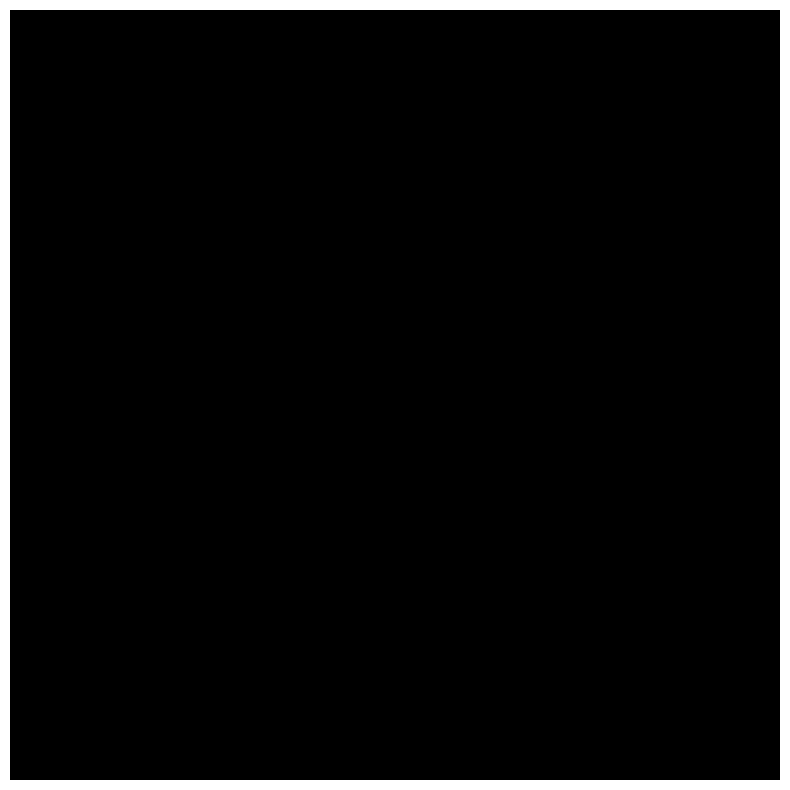

In [55]:
# experiment 2

import torch
from pytorch3d.renderer import (
    look_at_view_transform, 
    FoVOrthographicCameras, 
    PointsRasterizationSettings, 
    PointsRasterizer, 
    PointsRenderer, 
    AlphaCompositor
)
import matplotlib.pyplot as plt

# Assuming you've extracted the translation and rotation matrices from the XML:
translation_vector = torch.tensor([1.95964, 2.48625, -72.0238], device=device)
rotation_matrix = torch.tensor([
    [0.948812, -0.313756, 0.0362285],
    [0.0965776, 0.397423, 0.912539],
    [-0.300713, -0.862329, 0.407382]
], device=device)

# Convert these values to PyTorch3D's expected format for R and T.
R = rotation_matrix.unsqueeze(0)  # Shape [1, 3, 3]
T = translation_vector.unsqueeze(0)  # Shape [1, 3]

# Set the camera with the provided settings.
cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)

# The rest of the code remains the same.
raster_settings = PointsRasterizationSettings(
    image_size=512,
    radius=0.003,
    points_per_pixel=10
)

rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
renderer = PointsRenderer(
    rasterizer=rasterizer,
    compositor=AlphaCompositor()
)

images = renderer(point_cloud)
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off")
plt.show()

interactive(children=(FloatSlider(value=0.0, description='Azimuth:', max=180.0, min=-180.0, step=1.0), FloatSl…

In [6]:
import torch
from pytorch3d.renderer import look_at_view_transform, FoVOrthographicCameras, PointsRasterizationSettings, PointsRasterizer, PointsRenderer, AlphaCompositor
from pytorch3d.structures import Pointclouds
import ipywidgets as widgets
from IPython.display import display
import matplotlib.pyplot as plt

def render_pointcloud(distance=20.0, elevation=10.0, azimuth=0.0):
    # Get the camera position
    R, T = look_at_view_transform(distance, elevation, azimuth, device=device)

    cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)

    raster_settings = PointsRasterizationSettings(
        image_size=512,
        radius=0.003,
        points_per_pixel=10
    )

    rasterizer = PointsRasterizer(cameras=cameras, raster_settings=raster_settings)
    renderer = PointsRenderer(
        rasterizer=rasterizer,
        # compositor=AlphaCompositor()
        compositor=AlphaCompositor(background_color=(0, 0, 1))
    )

    images = renderer(point_cloud)

    plt.figure(figsize=(10, 10))
    plt.imshow(images[0, ..., :3].cpu().numpy())
    plt.axis("off")
    plt.show()

# Create widgets
distance_slider = widgets.FloatSlider(value=20.0, min=1.0, max=100.0, step=1.0, description='Distance:')
elevation_slider = widgets.FloatSlider(value=10.0, min=-180.0, max=180.0, step=1.0, description='Elevation:')
azimuth_slider = widgets.FloatSlider(value=0.0, min=-180.0, max=180.0, step=1.0, description='Azimuth:')
interactive_plot = widgets.interactive(render_pointcloud, distance=distance_slider, elevation=elevation_slider, azimuth=azimuth_slider)
output = interactive_plot.children[-1]
display(interactive_plot)

interactive(children=(FloatSlider(value=20.0, description='Distance:', min=1.0, step=1.0), FloatSlider(value=1…

We will now modify the **renderer** to use **alpha compositing** with a set background color.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


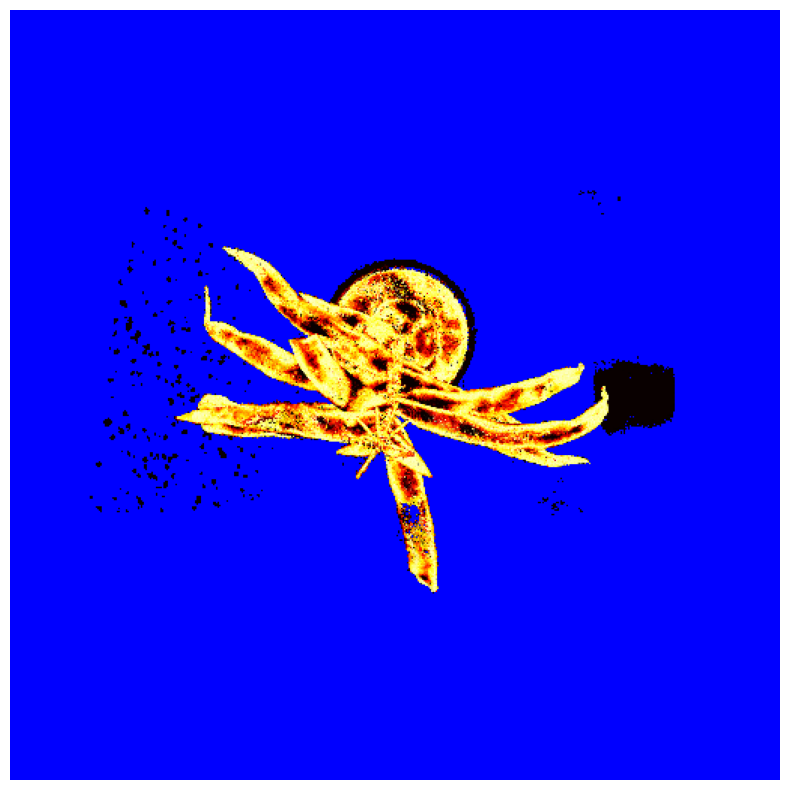

In [8]:
renderer = PointsRenderer(
    rasterizer=rasterizer,
    # Pass in background_color to the alpha compositor, setting the background color
    # to the 3 item tuple, representing rgb on a scale of 0 -> 1, in this case blue
    compositor=AlphaCompositor(background_color=(0, 0, 1))
)
images = renderer(point_cloud)

plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off");

In this example we will first create a **renderer** which uses an **orthographic camera**, and applies **weighted compositing**.

In [54]:
# Initialize a camera.
R, T = look_at_view_transform(20, 10, 0)
cameras = FoVOrthographicCameras(device=device, R=R, T=T, znear=0.01)

# Define the settings for rasterization and shading. Here we set the output image to be of size
# 512x512. As we are rendering images for visualization purposes only we will set faces_per_pixel=1
# and blur_radius=0.0. Refer to rasterize_points.py for explanations of these parameters.
raster_settings = PointsRasterizationSettings(
    image_size=512,
    radius = 0.003,
    points_per_pixel = 10
)


# Create a points renderer by compositing points using an weighted compositor (3D points are
# weighted according to their distance to a pixel and accumulated using a weighted sum)
renderer = PointsRenderer(
    rasterizer=PointsRasterizer(cameras=cameras, raster_settings=raster_settings),
    compositor=NormWeightedCompositor()
)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


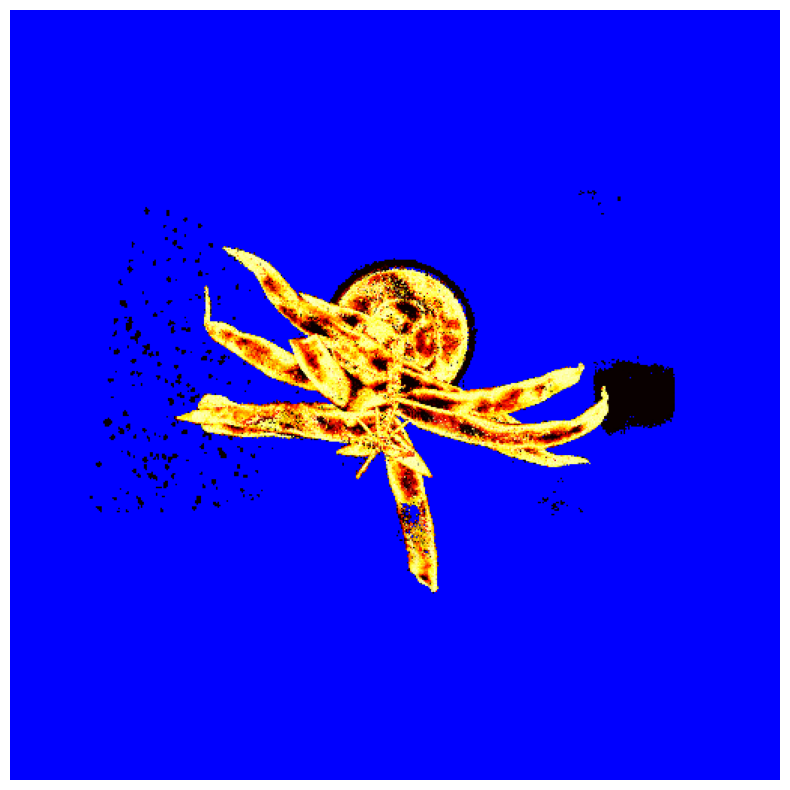

In [9]:
images = renderer(point_cloud)
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off");

We will now modify the **renderer** to use **weighted compositing** with a set background color.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


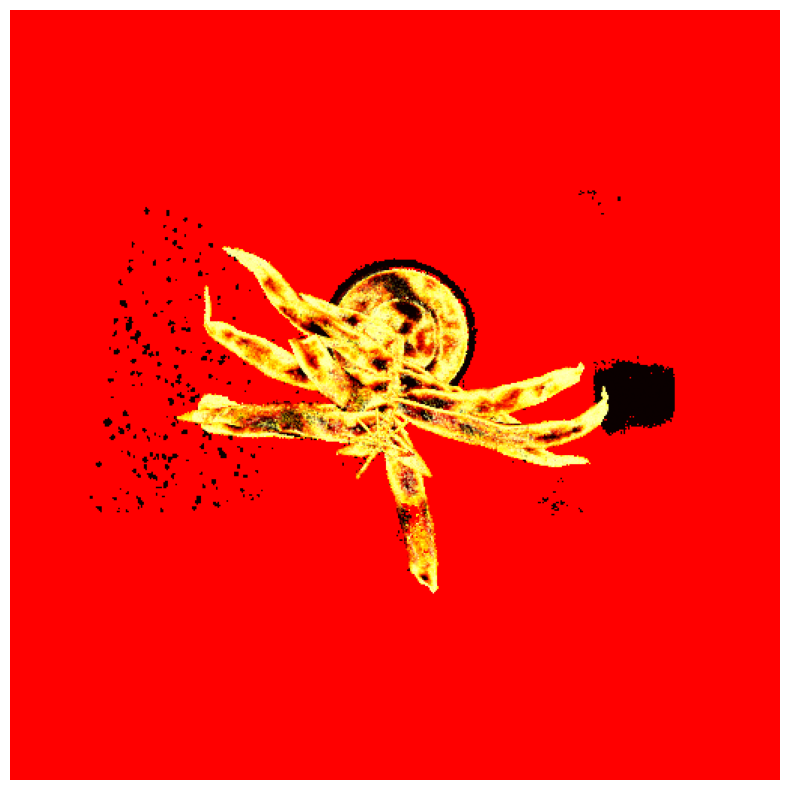

In [10]:
renderer = PointsRenderer(
    rasterizer=PointsRasterizer(cameras=cameras, raster_settings=raster_settings),
    # Pass in background_color to the norm weighted compositor, setting the background color
    # to the 3 item tuple, representing rgb on a scale of 0 -> 1, in this case red
    compositor=NormWeightedCompositor(background_color=(1,0,0))
)
images = renderer(point_cloud)
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off");

## Using the pulsar backend

Switching to the pulsar backend is easy! The pulsar backend has a compositor built-in, so the `compositor` argument is not required when creating it (a warning will be displayed if you provide it nevertheless). It pre-allocates memory on the rendering device, that's why it needs the `n_channels` at construction time.

All parameters for the renderer forward function are batch-wise except the background color (in this example, `gamma`) and you have to provide as many values as you have examples in your batch. The background color is optional and by default set to all zeros. You can find a detailed explanation of how gamma influences the rendering function here in the paper [Fast Differentiable Raycasting for Neural Rendering using
Sphere-based Representations](https://arxiv.org/pdf/2004.07484.pdf).

You can also use the `native` backend for the pulsar backend which already provides access to point opacity. The native backend can be imported from `pytorch3d.renderer.points.pulsar`; you can find examples for this in the folder `docs/examples`.

In [11]:
renderer = PulsarPointsRenderer(
    rasterizer=PointsRasterizer(cameras=cameras, raster_settings=raster_settings),
    n_channels=4
).to(device)

images = renderer(point_cloud, gamma=(1e-4,),
                  bg_col=torch.tensor([0.0, 1.0, 0.0, 1.0], dtype=torch.float32, device=device))
plt.figure(figsize=(10, 10))
plt.imshow(images[0, ..., :3].cpu().numpy())
plt.axis("off");

RuntimeError: invalid argument 2: Vertex colors must have the right number of channels (have shape 3, need 4)!

### View pointclouds in Plotly figures

Here we use the PyTorch3D function `plot_scene` to render the pointcloud in a Plotly figure. `plot_scene` returns a plotly figure with trace and subplots defined by the input.

In [12]:
plot_scene({
    "Pointcloud": {
        "person": point_cloud
    }
})

We will now render a batch of pointclouds. The first pointcloud is the same as above, and the second is all-black and offset by 2 in all dimensions so we can see them on the same plot.

In [13]:
point_cloud_batch = Pointclouds(points=[verts, verts + 2], features=[rgb, torch.zeros_like(rgb)])
# render both in the same plot in different traces
fig = plot_scene({
    "Pointcloud": {
        "person": point_cloud_batch[0],
        "person2": point_cloud_batch[1]
    }
})
fig.show()

In [14]:
# render both in the same plot in one trace
fig = plot_scene({
    "Pointcloud": {
        "2 people": point_cloud_batch
    }
})
fig.show()

For batches, we can also use `plot_batch_individually` to avoid constructing the scene dictionary ourselves.

In [15]:
# render both in 1 row in different subplots
fig2 = plot_batch_individually(point_cloud_batch, ncols=2)
fig2.show()

In [16]:
# modify the plotly figure height and width
fig2.update_layout(height=500, width=500)
fig2.show()

We can also modify the axis arguments and axis backgrounds for either function, and title our plots in `plot_batch_individually`.

In [17]:
fig3 = plot_batch_individually(
    point_cloud_batch,
    xaxis={"backgroundcolor":"rgb(200, 200, 230)"},
    yaxis={"backgroundcolor":"rgb(230, 200, 200)"},
    zaxis={"backgroundcolor":"rgb(200, 230, 200)"},
    subplot_titles=["Pointcloud1", "Pointcloud2"], # this should have a title for each subplot, titles can be ""
    axis_args=AxisArgs(showgrid=True))
fig3.show()